# Exploratory Data Analysis (EDA)

In [270]:
!pip install category_encoders

In [271]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import operator
import plotly.graph_objects as go

In [272]:
df = pd.read_csv("../data/clean/clean.csv", sep=',')

In [273]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [274]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

In [275]:
df.shape

(41176, 21)

In [276]:
df.age.describe()

count    41176.00000
mean        40.02380
std         10.42068
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64

- The average customer is 40 years old.

In [277]:
df.age.median()

38.0

In [278]:
df.age.value_counts()

31    1947
32    1845
33    1833
36    1779
35    1758
      ... 
89       2
91       2
87       1
94       1
95       1
Name: age, Length: 78, dtype: int64

- The biggest group of customers is 31 years old.

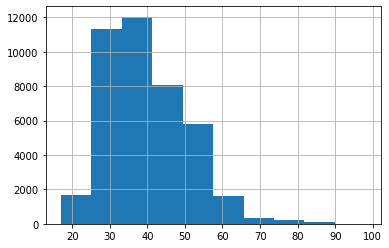

In [279]:
df.age.hist()

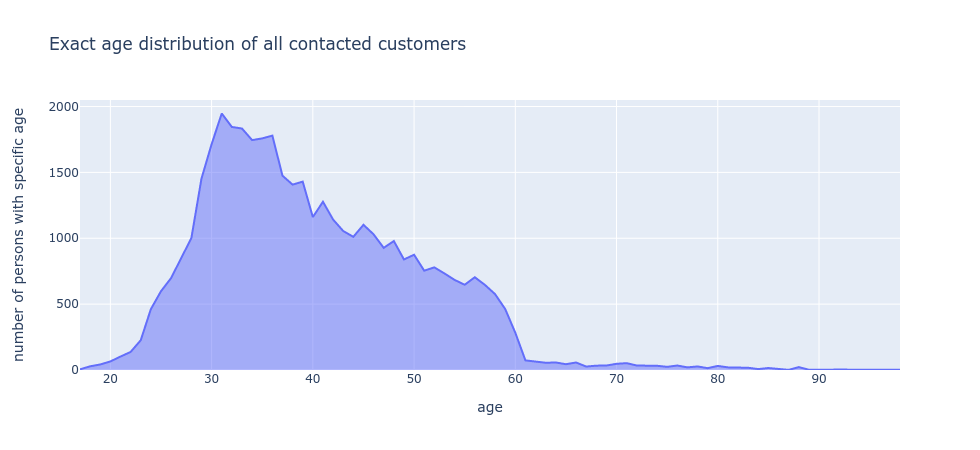

In [280]:
age_counts = df.age.value_counts()
px.area(age_counts, x=age_counts.index, y=age_counts.values, title="Exact age distribution of all contacted customers", labels={"y":"number of persons with specific age", "x":"age"})

## How old is the average customer, who actually subscribed to a term deposit?

In [281]:
df[df.y == 'yes'].age.mean()

40.91226557447726

- The average customer, who actually subscribed to a term deposit is around 40.9 years old.

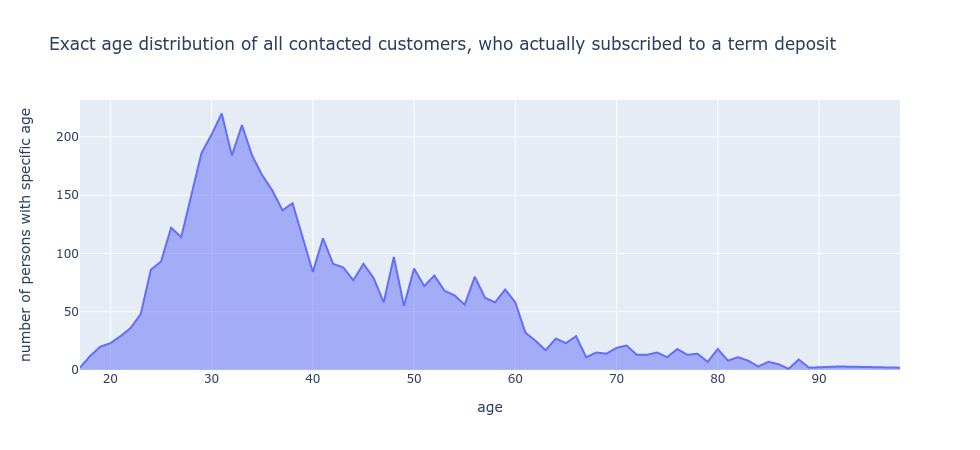

In [282]:
age_counts = df[df.y == 'yes'].age.value_counts()
px.area(age_counts, x=age_counts.index, y=age_counts.values, title="Exact age distribution of all contacted customers, who actually subscribed to a term deposit", labels={"y":"number of persons with specific age", "x":"age"})

## How old is the average customer, who did not subscribe to a term deposit?

In [283]:
df[df.y == 'no'].age.mean()

39.91099433451022

- The average customer, who did not subscribe to a term deposit is around 39.9 years old.

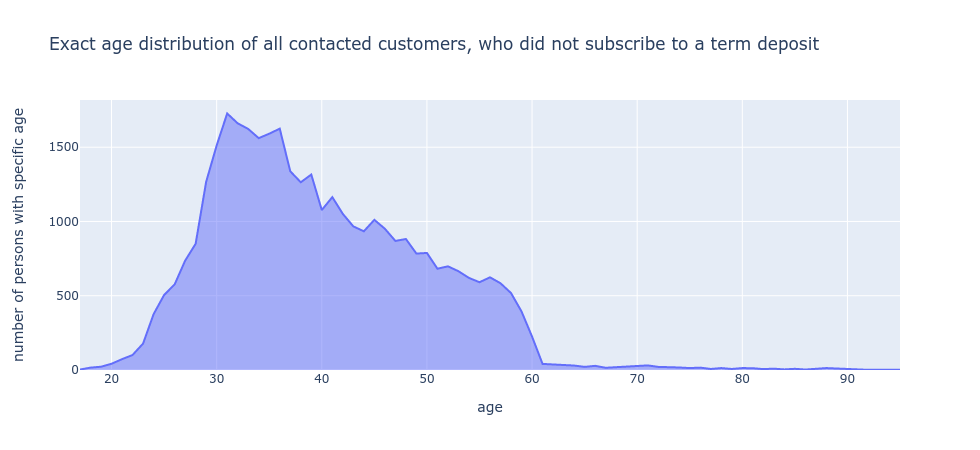

In [284]:
age_counts = df[df.y == 'no'].age.value_counts()
px.area(age_counts, x=age_counts.index, y=age_counts.values, title="Exact age distribution of all contacted customers, who did not subscribe to a term deposit", labels={"y":"number of persons with specific age", "x":"age"})

## Show some box plots concerning the customers' age

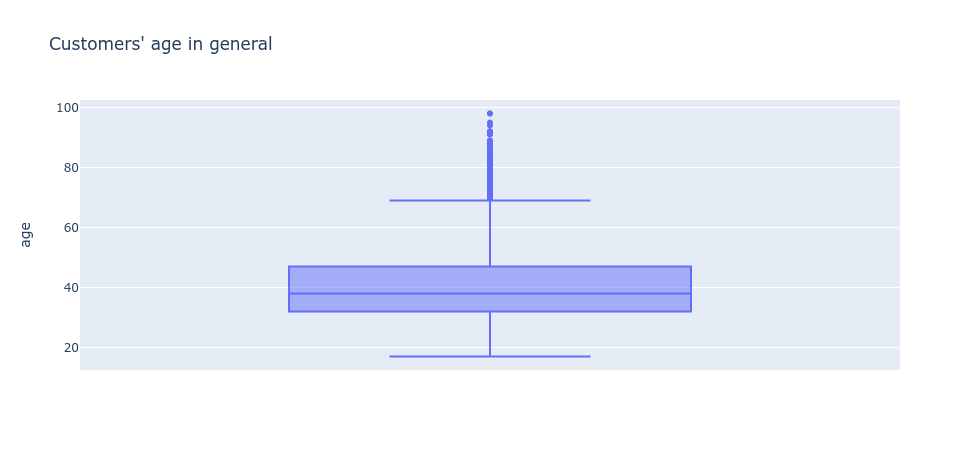

In [285]:
px.box(df, y="age", title="Customers' age in general")

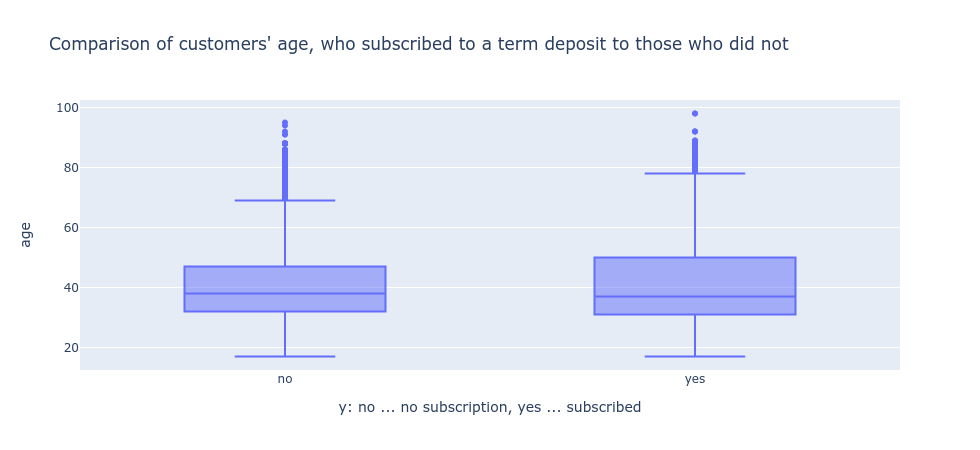

In [286]:
px.box(df, y="age", x="y", title="Comparison of customers' age, who subscribed to a term deposit to those who did not", labels={"y":"y: no ... no subscription, yes ... subscribed"})

In [287]:
df.job.unique()

array(['housemaid', 'services', 'admin.', 'blue-collar', 'technician',
       'retired', 'management', 'unemployed', 'self-employed', 'unknown',
       'entrepreneur', 'student'], dtype=object)

In [288]:
df.job.nunique()

12

In [289]:
df.job.value_counts()

admin.           10419
blue-collar       9253
technician        6739
services          3967
management        2924
retired           1718
entrepreneur      1456
self-employed     1421
housemaid         1060
unemployed        1014
student            875
unknown            330
Name: job, dtype: int64

- Most customers work in the admin. sector.
- These are followed by customers working as a blue-collar.
- These are followed by technicians and customers working in services.

# Distribution of customers in terms of their job

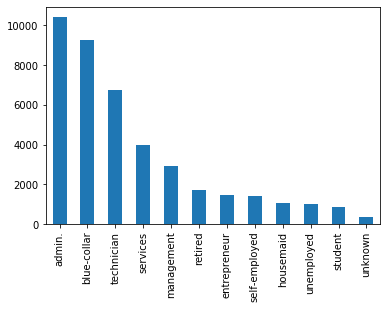

In [290]:
df.job.value_counts().plot(kind="bar")

### Different representations

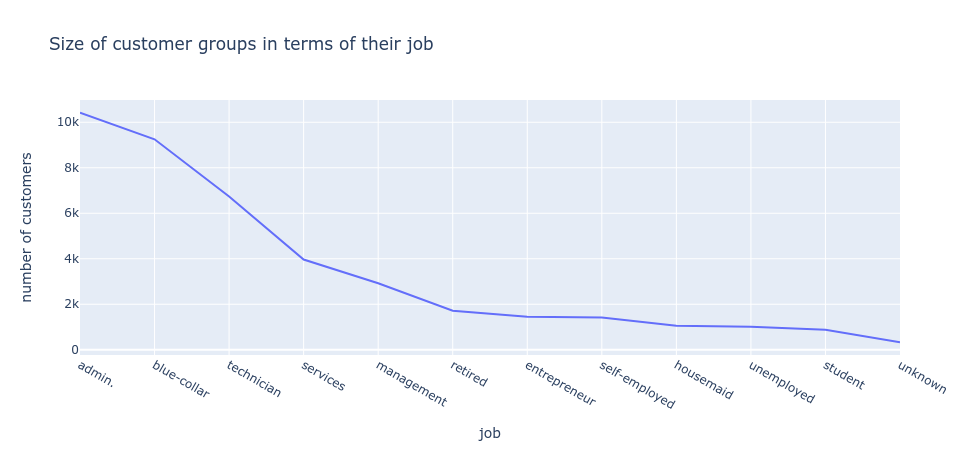

In [291]:
data_job = df.job.value_counts()
px.line(data_job, x=data_job.index, y=data_job.values, labels={"x":"job", "y": "number of customers"}, title="Size of customer groups in terms of their job")

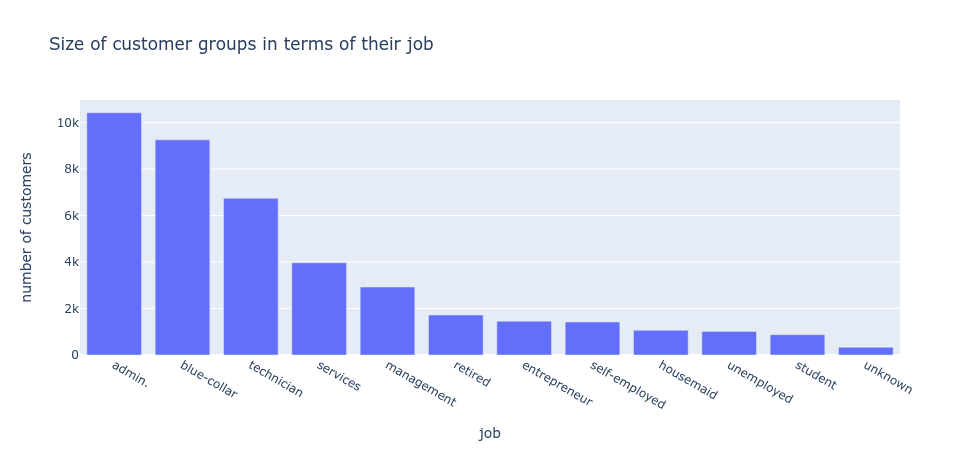

In [292]:
px.bar(data_job, x=data_job.index, y=data_job.values, labels={"x":"job", "y": "number of customers"}, title="Size of customer groups in terms of their job")

In [293]:
df.marital.value_counts()

married     24921
single      11564
divorced     4611
unknown        80
Name: marital, dtype: int64

- Most customers are married.

In [294]:
df.education.value_counts()

university.degree      12164
high.school             9512
basic.9y                6045
professional.course     5240
basic.4y                4176
basic.6y                2291
unknown                 1730
illiterate                18
Name: education, dtype: int64

- Most customers have a university degree.

In [295]:
df.default.value_counts()

no         32577
unknown     8596
yes            3
Name: default, dtype: int64

- Most values for "default" are "no", meaning most customers have no credit in default.
- Only three customers answered with "yes".

In [296]:
df.housing.value_counts()

yes        21571
no         18615
unknown      990
Name: housing, dtype: int64

- Most customers have a housing loan.

In [297]:
df.loan.value_counts()

no         33938
yes         6248
unknown      990
Name: loan, dtype: int64

- Most customers have no personal loan.

In [298]:
df.contact.value_counts()

cellular     26135
telephone    15041
Name: contact, dtype: int64

- Most customers were contacted via the cellular phone.

In [299]:
df.month.value_counts()

may    13767
jul     7169
aug     6176
jun     5318
nov     4100
apr     2631
oct      717
sep      570
mar      546
dec      182
Name: month, dtype: int64

- Most customers were contacted in May.

In [300]:
df.day_of_week.value_counts()

thu    8618
mon    8512
wed    8134
tue    8086
fri    7826
Name: day_of_week, dtype: int64

- With a minor difference, most customers were contaced on Thurdsay.

In [301]:
df.duration.describe()

count    41176.000000
mean       258.315815
std        259.305321
min          0.000000
25%        102.000000
50%        180.000000
75%        319.000000
max       4918.000000
Name: duration, dtype: float64

- The average phone call lasted 258.3 seconds (= about 4.3 minutes).
- The longest phone call lasted 4918 seconds (= about 82 minutes).

In [302]:
df.duration.median()

180.0

In [303]:
df.duration.value_counts()

85      170
90      170
136     168
73      167
124     163
       ... 
1108      1
980       1
4918      1
2453      1
2015      1
Name: duration, Length: 1544, dtype: int64

In [304]:
df.campaign.describe()

count    41176.000000
mean         2.567879
std          2.770318
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         56.000000
Name: campaign, dtype: float64

## How many contacts were performed during this campaign and for a specific client on average?

- The number of contacts performed during this campaign and for a client is on average 2.568.

In [305]:
df.campaign.median()

2.0

- The median shows, that there are two contacts.

## What is the success rate of customers which were contacted at most twice?

In [306]:
df[df.campaign <= 2].shape[0]

28202

- 28202 customers have been contacted at most twice.

In [307]:
df[(df.campaign <= 2) & (df.y == 'yes')].shape[0] / (df[(df.campaign <= 2) & (df.y == 'yes')].shape[0] + df[(df.campaign <= 2) & (df.y == 'no')].shape[0]) * 100

12.445925820863767

- The success rate of customers, which have been contacted at most twice is about 12.4%.

## Pick those customers, who had more than the median (2) contacts, and analyze them!

In [308]:
df[df.campaign > 2].shape[0]

12974

- 12974 customers were contacted more than twice.

### What is the success rate of those customers which subscribed after more than two contacts?

In [309]:
df[(df.campaign > 2) & (df.y == 'yes')].shape[0] / (df[(df.campaign > 2) & (df.y == 'yes')].shape[0] + df[(df.campaign > 2) & (df.y == 'no')].shape[0]) * 100

8.702019423462309

- The success rate for customers who were contacted more than twice is about 8.7%.

## How many contacts were performed on average with customers who actually subscribed to a term deposit in the last campaign?

In [310]:
df[df.y == 'yes'].campaign.mean()

2.051950851476611

- Customers who actually subscribed to a term deposit in the last campaign, had 2.05 contacts on average.
  - This may be one indicator out of others to find out whether a customer will subscribe or not, or whether it is worth to again contact the same customer.

In [311]:
df.campaign.value_counts()

1     17634
2     10568
3      5340
4      2650
5      1599
6       979
7       629
8       400
9       283
10      225
11      177
12      125
13       92
14       69
17       58
15       51
16       51
18       33
20       30
19       26
21       24
22       17
23       16
24       15
27       11
29       10
25        8
26        8
28        8
30        7
31        7
35        5
33        4
32        4
34        3
40        2
42        2
43        2
37        1
39        1
41        1
56        1
Name: campaign, dtype: int64

- Astonishingly, there was one customer, where 56 contacts were performed during the last campaign!
  - Let's further inspect this case:

In [312]:
df_inspect_56 = df[df.campaign == 56]
df_inspect_56

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
4106,32,admin.,married,university.degree,unknown,unknown,unknown,telephone,may,mon,...,56,999,0,nonexistent,1.1,93.994,-36.4,4.858,5191.0,no


In [313]:
df_inspect_56.y

4106    no
Name: y, dtype: object

- The customer (32 years old, married, with university degree), who had 56 contacts finally did not subscribe to a term deposit, so it was not worth the effort.

In [314]:
df.pdays.describe()

count    41176.000000
mean       962.464810
std        186.937102
min          0.000000
25%        999.000000
50%        999.000000
75%        999.000000
max        999.000000
Name: pdays, dtype: float64

- The average number of days that passed by after the client was last contacted from a previous campaign is 962.46 days.

In [315]:
df.pdays.median()

999.0

In [316]:
df.pdays.value_counts()

999    39661
3        439
6        412
4        118
9         64
2         61
7         60
12        58
10        52
5         46
13        36
11        28
1         26
15        24
14        20
8         18
0         15
16        11
17         8
18         7
19         3
22         3
21         2
26         1
20         1
25         1
27         1
Name: pdays, dtype: int64

- Most customers have been contacted 999 days ago before his campaign.

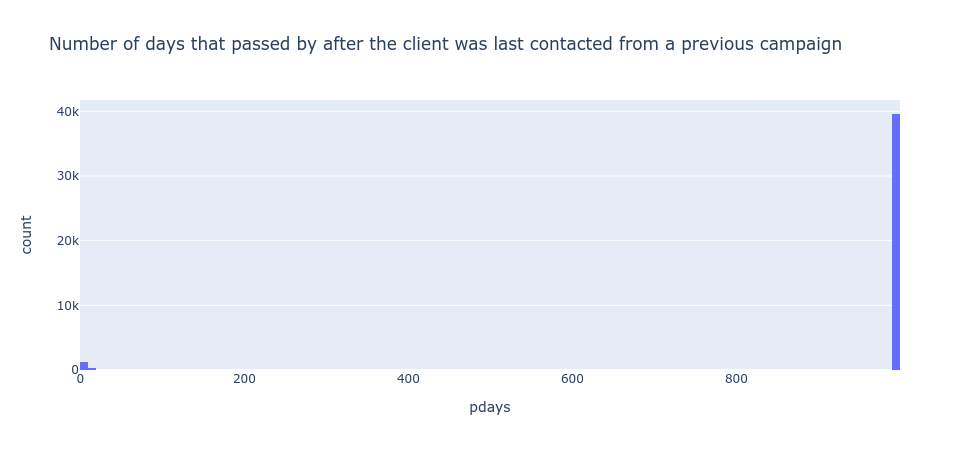

In [317]:
px.histogram(df, x="pdays", title="Number of days that passed by after the client was last contacted from a previous campaign", labels={"x":"number of days (pdays)", "y":"amount of customers"})

In [318]:
df.previous.describe()

count    41176.000000
mean         0.173013
std          0.494964
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.000000
Name: previous, dtype: float64

- On average, the customers have subscribed to 0.173 term deposits previously.

In [319]:
df.previous.median()

0.0

In [320]:
df.previous.value_counts()

0    35551
1     4561
2      754
3      216
4       70
5       18
6        5
7        1
Name: previous, dtype: int64

In [321]:
df.poutcome.value_counts()

nonexistent    35551
failure         4252
success         1373
Name: poutcome, dtype: int64

- For most contacted customers it was the first marketing campaign.

In [322]:
df['emp.var.rate'].describe()

count    41176.000000
mean         0.081922
std          1.570883
min         -3.400000
25%         -1.800000
50%          1.100000
75%          1.400000
max          1.400000
Name: emp.var.rate, dtype: float64

In [323]:
df['emp.var.rate'].median()

1.1

In [324]:
df['emp.var.rate'].value_counts()

 1.4    16228
-1.8     9182
 1.1     7762
-0.1     3682
-2.9     1662
-3.4     1070
-1.7      773
-1.1      635
-3.0      172
-0.2       10
Name: emp.var.rate, dtype: int64

In [325]:
df['cons.price.idx'].describe()

count    41176.000000
mean        93.575720
std          0.578839
min         92.201000
25%         93.075000
50%         93.749000
75%         93.994000
max         94.767000
Name: cons.price.idx, dtype: float64

In [326]:
df['cons.price.idx'].median()

93.749

In [327]:
df['cons.price.idx'].value_counts()

93.994    7762
93.918    6681
92.893    5793
93.444    5173
94.465    4374
93.200    3615
93.075    2457
92.201     770
92.963     715
92.431     446
92.649     357
94.215     311
94.199     303
92.843     282
92.379     267
93.369     264
94.027     233
94.055     229
93.876     212
94.601     204
92.469     177
93.749     174
92.713     172
94.767     128
93.798      67
92.756      10
Name: cons.price.idx, dtype: int64

In [328]:
df['cons.conf.idx'].describe()

count    41176.000000
mean       -40.502863
std          4.627860
min        -50.800000
25%        -42.700000
50%        -41.800000
75%        -36.400000
max        -26.900000
Name: cons.conf.idx, dtype: float64

In [329]:
df['cons.conf.idx'].median()

-41.8

In [330]:
df['cons.conf.idx'].value_counts()

-36.4    7762
-42.7    6681
-46.2    5793
-36.1    5173
-41.8    4374
-42.0    3615
-47.1    2457
-31.4     770
-40.8     715
-26.9     446
-30.1     357
-40.3     311
-37.5     303
-50.0     282
-29.8     267
-34.8     264
-38.3     233
-39.8     229
-40.0     212
-49.5     204
-33.6     177
-34.6     174
-33.0     172
-50.8     128
-40.4      67
-45.9      10
Name: cons.conf.idx, dtype: int64

In [331]:
df.euribor3m.describe()

count    41176.000000
mean         3.621293
std          1.734437
min          0.634000
25%          1.344000
50%          4.857000
75%          4.961000
max          5.045000
Name: euribor3m, dtype: float64

- The average euribor3m value was 3.62.

In [332]:
df.euribor3m.median()

4.857

In [333]:
df.euribor3m.value_counts()

4.857    2868
4.962    2611
4.963    2487
4.961    1902
4.856    1210
         ... 
3.053       1
0.956       1
1.045       1
0.996       1
0.933       1
Name: euribor3m, Length: 316, dtype: int64

In [334]:
df['nr.employed'].describe()

count    41176.000000
mean      5167.034870
std         72.251364
min       4963.600000
25%       5099.100000
50%       5191.000000
75%       5228.100000
max       5228.100000
Name: nr.employed, dtype: float64

In [335]:
df['nr.employed'].median()

5191.0

In [336]:
df['nr.employed'].value_counts()

5228.1    16228
5099.1     8532
5191.0     7762
5195.8     3682
5076.2     1662
5017.5     1070
4991.6      773
5008.7      650
4963.6      635
5023.5      172
5176.3       10
Name: nr.employed, dtype: int64

## Is the output variable balanced?

In [337]:
y_counts = df.y.value_counts()
y_counts

no     36537
yes     4639
Name: y, dtype: int64

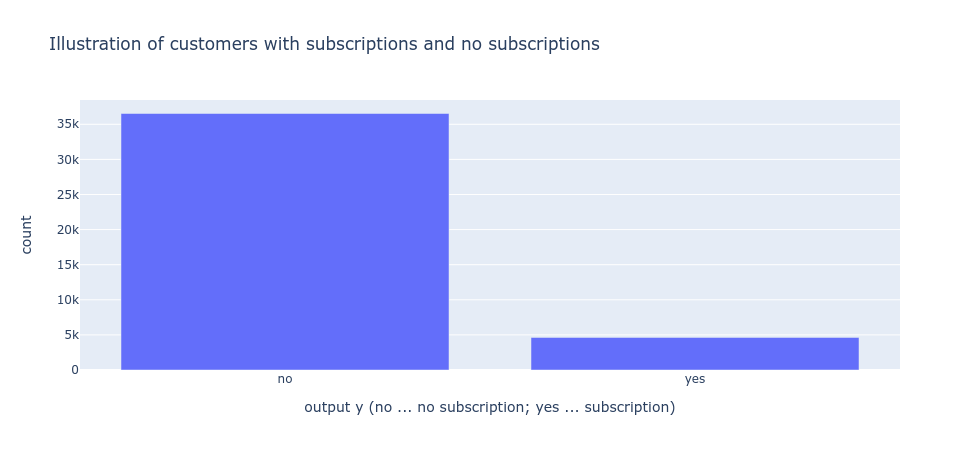

In [338]:
px.bar(x=y_counts.index, y=y_counts.values, labels={"x":"output y (no ... no subscription; yes ... subscription)", "y":"count"}, title="Illustration of customers with subscriptions and no subscriptions")

In [339]:
y_values = df.y.value_counts().values.tolist()
y_keys = df.y.value_counts().keys().tolist()

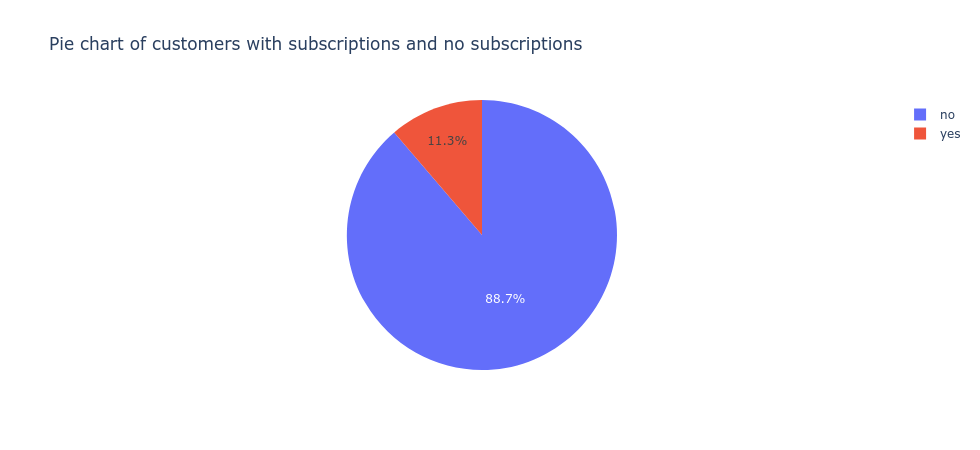

In [340]:
px.pie(values=y_values, names=y_keys, labels=y_keys, title='Pie chart of customers with subscriptions and no subscriptions')

- The output variable to predict is very imbalanced.
- Care needs to be taken, when predicting this output variable!

## Calculate the correlation matrix of the dataframe and find correlations to the output variable "y"!

**convert column "y" to binary value for the correlation matrix**

In [341]:
df.y = df.y.map({'no':0, 'yes':1})

**Calculate the correlation on the whole dataframe**

In [342]:
correlation_matrix = df.corr() # results in a correlation matrix
correlation_matrix

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
age,1.000000,-0.000808,0.004622,-0.034381,0.024379,-0.000242,0.001009,0.129075,0.010852,-0.017607,0.030381
duration,-0.000808,1.000000,-0.071765,-0.047556,0.020600,-0.027941,0.005303,-0.008126,-0.032861,-0.044672,0.405297
campaign,0.004622,-0.071765,1.000000,0.052606,-0.079182,0.150786,0.127826,-0.013657,0.135169,0.144129,-0.066361
pdays,-0.034381,-0.047556,0.052606,1.000000,-0.587508,0.271063,0.078920,-0.091374,0.296946,0.372659,-0.324948
previous,0.024379,0.020600,-0.079182,-0.587508,1.000000,-0.420587,-0.203197,-0.050929,-0.454571,-0.501411,0.230202
emp.var.rate,-0.000242,-0.027941,0.150786,0.271063,-0.420587,1.000000,0.775293,0.196257,0.972244,0.906949,-0.298289
cons.price.idx,0.001009,0.005303,0.127826,0.078920,-0.203197,0.775293,1.000000,0.059170,0.688180,0.521945,-0.136134
cons.conf.idx,0.129075,-0.008126,-0.013657,-0.091374,-0.050929,0.196257,0.059170,1.000000,0.277864,0.100679,0.054802
euribor3m,0.010852,-0.032861,0.135169,0.296946,-0.454571,0.972244,0.688180,0.277864,1.000000,0.945146,-0.307740
nr.employed,-0.017607,-0.044672,0.144129,0.372659,-0.501411,0.906949,0.521945,0.100679,0.945146,1.000000,-0.354669


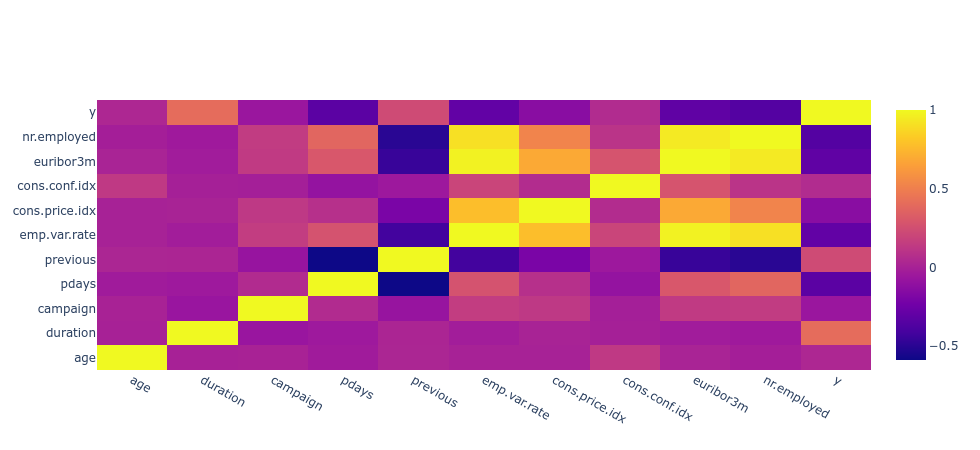

In [343]:
fig = go.Figure(data=go.Heatmap(x=correlation_matrix.columns, y=correlation_matrix.columns,z=correlation_matrix))
fig.show()

**_Observation:_**
**Higher correlations with "y" are:**
- duration: 0.405
- previous: 0.2302
- cons.conf.idx: 0.0548
- age: 0.0309

## How are the jobs distributed over the age?

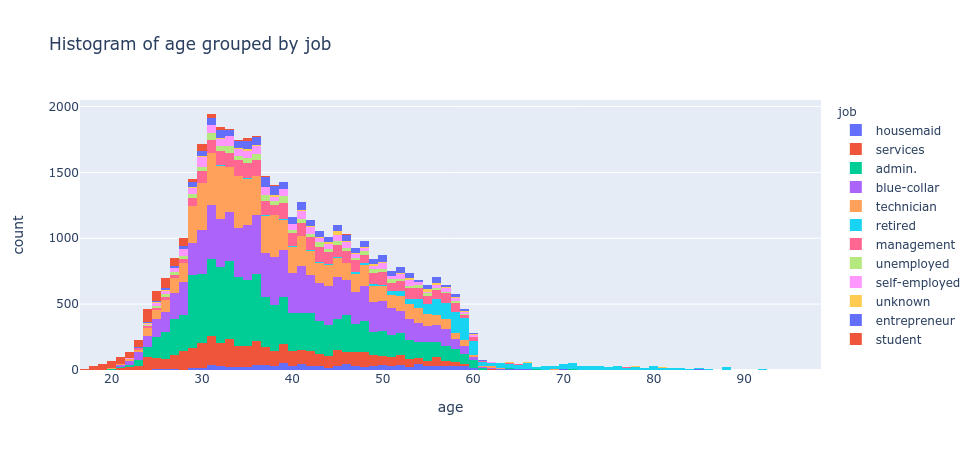

In [344]:
px.histogram(df, x="age", color="job", title="Histogram of age grouped by job")

- The joungest customers are 17.

- In the age group from 17 to 19, all recorded customers are students.

- In the joung age group from 17 to 22, the major customer group are students.

- Most term deposits are subscribed in the age group 29 to 39.

    - In this age group admin. jobs dominate.


- Starting with age 58, most customers are are retired.

- The oldest customers are 98.

In [345]:
df.age.describe()

count    41176.00000
mean        40.02380
std         10.42068
min         17.00000
25%         32.00000
50%         38.00000
75%         47.00000
max         98.00000
Name: age, dtype: float64

- The average customer is 40 years old.

- 50% of the customers are 38 years old.

In [346]:
df.age.median()

38.0

## Show the trend of the subscribed vs. not subscribed term deposits over the age

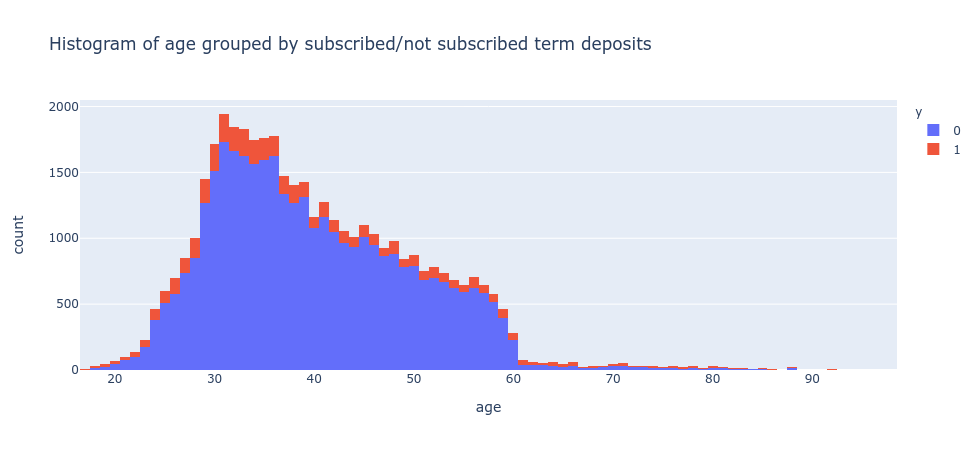

In [347]:
px.histogram(df, x="age", color="y", title="Histogram of age grouped by subscribed/not subscribed term deposits")

- Logically, the more customers are contacted by age, the more customers will not subscribe to a term deposit.

## Which jobs have mostly subscribed to a term deposit?

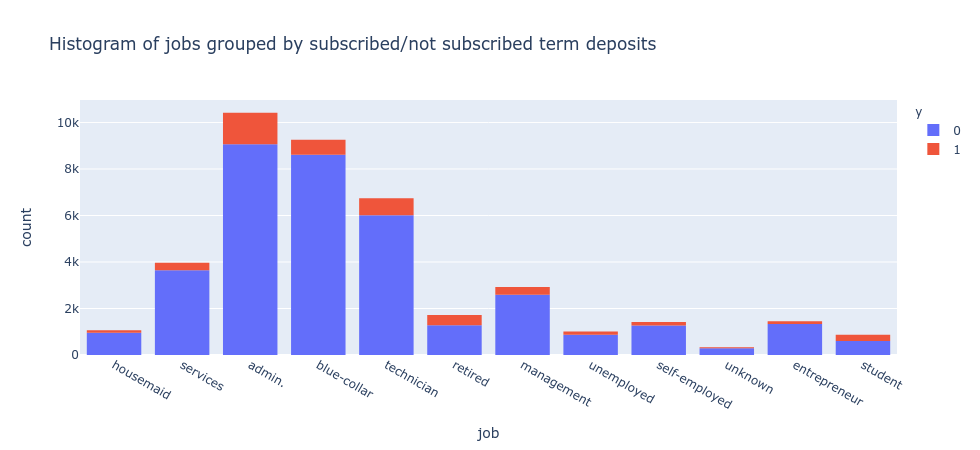

In [348]:
px.histogram(df, x="job", color="y", title="Histogram of jobs grouped by subscribed/not subscribed term deposits")

In decending order, the following jobs mostly subscribed to a term deposit:
1. admin.
2. blue-collar
3. technician
4. services
5. management

In [349]:
vc_jobs_reset = df.job.value_counts().reset_index()
vc_jobs_reset

,index,job
0,admin.,10419
1,blue-collar,9253
2,technician,6739
3,services,3967
4,management,2924
5,retired,1718
6,entrepreneur,1456
7,self-employed,1421
8,housemaid,1060
9,unemployed,1014


In [350]:
vc_jobs_reset["%"] = vc_jobs_reset.job / df.shape[0] * 100
vc_jobs_reset

,index,job,%
0,admin.,10419,25.303575
1,blue-collar,9253,22.471828
2,technician,6739,16.366330
3,services,3967,9.634253
4,management,2924,7.101224
5,retired,1718,4.172333
6,entrepreneur,1456,3.536040
7,self-employed,1421,3.451039
8,housemaid,1060,2.574315
9,unemployed,1014,2.462600


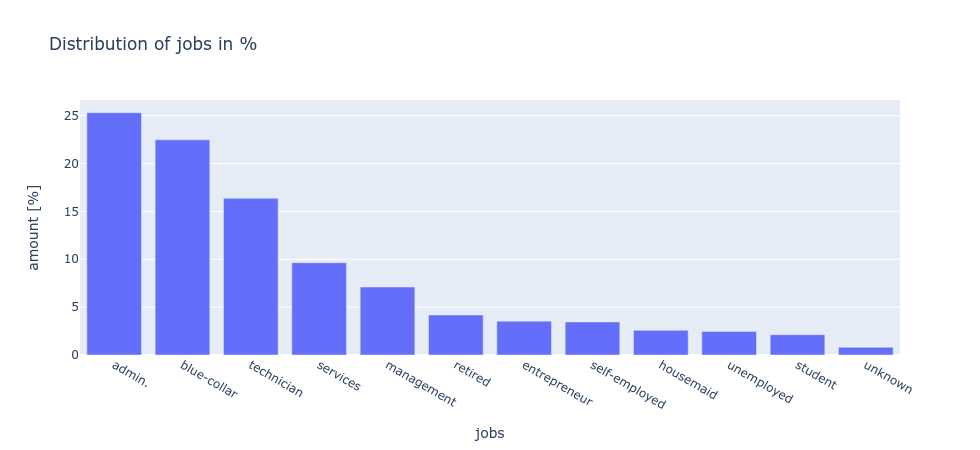

In [351]:
px.bar(x=vc_jobs_reset["index"], y=vc_jobs_reset["%"], title="Distribution of jobs in %", labels={"x":"jobs", "y":"amount [%]"})

- More than 1 quater of all customers have an admin. job.
- Students are a minority of ~2.1%.

## Show the subscription rate grouped by education!

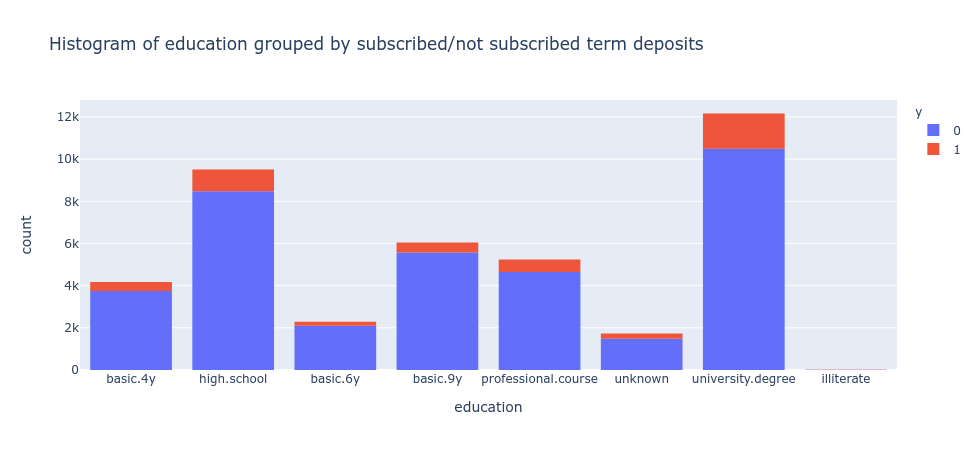

In [352]:
px.histogram(df, x="education", color="y", title="Histogram of education grouped by subscribed/not subscribed term deposits")

In decreasing order, most customers have the following educational background:
1. university degree
2. high school
3. basic 9 years
4. professional course

- Hardly any customers are illiterates.
- The second smallest group are customers where their educational background is unknown.

In [353]:
vc_edu_reset = df.education.value_counts().reset_index()
vc_edu_reset

,index,education
0,university.degree,12164
1,high.school,9512
2,basic.9y,6045
3,professional.course,5240
4,basic.4y,4176
5,basic.6y,2291
6,unknown,1730
7,illiterate,18


In [354]:
vc_edu_reset["%"] = vc_edu_reset.education / df.shape[0] * 100
vc_edu_reset

,index,education,%
0,university.degree,12164,29.541480
1,high.school,9512,23.100835
2,basic.9y,6045,14.680882
3,professional.course,5240,12.725860
4,basic.4y,4176,10.141830
5,basic.6y,2291,5.563921
6,unknown,1730,4.201477
7,illiterate,18,0.043715


In [355]:
px.bar(x=vc_edu_reset["index"], y=vc_edu_reset["%"], title="Distribution of educational background of customers in %", labels={"x":"educational level", "y":"amount [%]"})

- Nearly a third (29.5%) of all customers have a university degree.

## For which educational levels of the customers was the last campaign most successful?

In [356]:
group_edu_y = df.groupby(["education", "y"]).size()
group_edu_y_reset = group_edu_y.reset_index()
curr_columns = group_edu_y_reset.columns.values
curr_columns[2] = "count"
group_edu_y_reset.columns = curr_columns
#group_edu_y_reset = pd.DataFrame(group_edu_y_reset) # info: not needed
group_edu_y_reset.y = group_edu_y_reset.y.map({0:'no', 1:'yes'})
group_edu_y_reset

,education,y,count
0,basic.4y,no,3748
1,basic.4y,yes,428
2,basic.6y,no,2103
3,basic.6y,yes,188
4,basic.9y,no,5572
5,basic.9y,yes,473
6,high.school,no,8481
7,high.school,yes,1031
8,illiterate,no,14
9,illiterate,yes,4


In [357]:
px.bar(group_edu_y_reset, x="education", y="count", color="y", barmode='group', title="Comparison of success (yes) vs. no success (no) grouped by education")

In [358]:
group_edu_y

education            y
basic.4y             0     3748
                     1      428
basic.6y             0     2103
                     1      188
basic.9y             0     5572
                     1      473
high.school          0     8481
                     1     1031
illiterate           0       14
                     1        4
professional.course  0     4645
                     1      595
university.degree    0    10495
                     1     1669
unknown              0     1479
                     1      251
dtype: int64

In [359]:
# calculate success rate
counter = 1
for edu in group_edu_y.index:
    if counter % 2 == 0:
        success_rate = (group_edu_y[edu[0]][1] / (group_edu_y[edu[0]][0] + group_edu_y[edu[0]][1])) * 100
        print (edu[0] + ":", success_rate.astype(float).round(1), "%")
    counter += 1

basic.4y: 10.2 %
basic.6y: 8.2 %
basic.9y: 7.8 %
high.school: 10.8 %
illiterate: 22.2 %
professional.course: 11.4 %
university.degree: 13.7 %
unknown: 14.5 %


- The highest success rate was achieved with illiterates (22.2%) and with people having an unknown education.
- Since illiterates are a very small target group and people with an unknown educational background are not an easy target group, they will be skipped, thus:
- The success rate of the most promising target groups are (in descending order):
1. Persons having a university degree (13.7%)
2. Persons having made professional courses (11.4%)
3. Persons having a high school degree (10.8%)

## For which job categories was the last campaign most successful?

In [360]:
group_job_y = df.groupby(["job", "y"]).size()
group_job_y_reset = group_job_y.reset_index()
curr_columns = group_job_y_reset.columns.values
curr_columns[2] = "count"
group_job_y_reset.columns = curr_columns
#group_job_y_reset = pd.DataFrame(group_job_y_reset) # info: not needed
group_job_y_reset.y = group_job_y_reset.y.map({0:'no', 1:'yes'})
group_job_y_reset

,job,y,count
0,admin.,no,9068
1,admin.,yes,1351
2,blue-collar,no,8615
3,blue-collar,yes,638
4,entrepreneur,no,1332
5,entrepreneur,yes,124
6,housemaid,no,954
7,housemaid,yes,106
8,management,no,2596
9,management,yes,328


In [361]:
px.bar(group_job_y_reset, x="job", y="count", color="y", barmode='group', title="Comparison of success (yes) vs. no success (no) grouped by job")

In [362]:
group_job_y

job            y
admin.         0    9068
               1    1351
blue-collar    0    8615
               1     638
entrepreneur   0    1332
               1     124
housemaid      0     954
               1     106
management     0    2596
               1     328
retired        0    1284
               1     434
self-employed  0    1272
               1     149
services       0    3644
               1     323
student        0     600
               1     275
technician     0    6009
               1     730
unemployed     0     870
               1     144
unknown        0     293
               1      37
dtype: int64

In [363]:
# calculate success rate
counter = 1
for job in group_job_y.index:
    if counter % 2 == 0:
        success_rate = (group_job_y[job[0]][1] / (group_job_y[job[0]][0] + group_job_y[job[0]][1])) * 100
        print (job[0] + ":", success_rate.astype(float).round(1), "%")
    counter += 1

admin.: 13.0 %
blue-collar: 6.9 %
entrepreneur: 8.5 %
housemaid: 10.0 %
management: 11.2 %
retired: 25.3 %
self-employed: 10.5 %
services: 8.1 %
student: 31.4 %
technician: 10.8 %
unemployed: 14.2 %
unknown: 11.2 %


The highest success rates were achieved with the following jobs (descending):
1. students (31.4%)
2. retired people (25.3%)
3. unemployed (14.2%)
4. admin. personnel (13.0%)

## Which impact has the marital status with a term deposit?

In [364]:
px.histogram(df, x="marital", color="y", title="Histogram of marital status grouped by subscribed/not subscribed term deposits")

- Most customers are married.
- Neglecting the customers, where the marital status is not known, the most seldom martial status is "divorced".

In [365]:
vc_marital_reset = df.marital.value_counts().reset_index()
vc_marital_reset["%"] = vc_marital_reset.marital / df.shape[0] * 100
px.bar(x=vc_marital_reset["index"], y=vc_marital_reset["%"], title="Distribution of the marital status in %", labels={"x":"marital status", "y":"amount [%]"})

- More than 60% of the customers are married.
- About 28% of the customers are single.
- Only 11% of the customers are divorced.

## Which impact has the housing loan status with a term deposit?

In [366]:
px.histogram(df, x="housing", color="y", title="Histogram of housing loan status grouped by subscribed/not subscribed term deposits")

- Most customers have a housing loan (52%).

In [367]:
vc_housing_reset = df.housing.value_counts().reset_index()
vc_housing_reset["%"] = vc_housing_reset.housing / df.shape[0] * 100
px.bar(x=vc_housing_reset["index"], y=vc_housing_reset["%"], title="Distribution of the housing loan status of the customers in %", labels={"x":"housing", "y":"amount [%]"})

# What is the personal loan status of the customers?

In [368]:
px.histogram(df, x="loan", color="y", title="Histogram of the personal loan status grouped by subscribed/not subscribed term deposits")

- Most customers have no personal loan.

In [369]:
vc_loan_reset = df.loan.value_counts().reset_index()
vc_loan_reset["%"] = vc_loan_reset.loan / df.shape[0] * 100
px.bar(x=vc_loan_reset["index"], y=vc_loan_reset["%"], title="Distribution of the personal loan status of the customers in %", labels={"x":"personal loan", "y":"amount [%]"})

- More than 80% of the customers have no personal loan.

## What is the default status of the customers?

In [370]:
df.default.value_counts()

no         32577
unknown     8596
yes            3
Name: default, dtype: int64

In [371]:
df[df.y == 1].default.value_counts()

no         4196
unknown     443
Name: default, dtype: int64

- There is no customer, who subscribed to a term deposit in the last campaign and has a credit in default.

In [372]:
df[df.y == 0].default.value_counts()

no         28381
unknown     8153
yes            3
Name: default, dtype: int64

- There are only three persons, who did not subscribe to a term deposit and have a credit in default.

In [373]:
px.histogram(df, x="default", color="y", title="Histogram of the default status grouped by subscribed/not subscribed term deposits", labels={"default":"default status"})

- Most customers (nearly 80%) have no credit in default:

In [374]:
vc_default_reset = df.default.value_counts().reset_index()
vc_default_reset["%"] = vc_default_reset.default / df.shape[0] * 100
px.bar(x=vc_default_reset["index"], y=vc_default_reset["%"], title="Distribution of the default status of the customers in %", labels={"x":"default status", "y":"amount [%]"})

## How have most customers been contacted?

In [375]:
px.histogram(df, x="contact", color="y", title="Histogram of contact methods grouped by subscribed/not subscribed term deposits")

- Most customers (~63.5%) have been contacted via a cellular phone.

In [376]:
vc_contact_reset = df.contact.value_counts().reset_index()
vc_contact_reset["%"] = vc_contact_reset.contact / df.shape[0] * 100
px.bar(x=vc_contact_reset["index"], y=vc_contact_reset["%"], title="Distribution of the contact method of the customers in %", labels={"x":"contact method", "y":"amount [%]"})

## In which months did many customers subscribe to term deposit?

In [377]:
px.histogram(df, x="month", color="y", title="Histogram of months grouped by subscribed/not subscribed term deposits")

In decending order, many customers subscribed to a term deposit in the following months:
1. May (~33%)
2. July (~17%)
3. August (~15%)
4. June (~13%)
5. November (~10%)
6. April (~6%)

In [378]:
vc_month_reset = df.month.value_counts().reset_index()
vc_month_reset["%"] = vc_month_reset.month / df.shape[0] * 100
px.bar(x=vc_month_reset["index"], y=vc_month_reset["%"], title="Distribution of the month where the customers were contacted in %", labels={"x":"month of contact", "y":"amount [%]"})

## Is there a significant difference in the weekday concerning the subscription to a term deposit?

In [379]:
px.histogram(df, x="day_of_week", color="y", title="Histogram of weekdays grouped by subscribed/not subscribed term deposits", labels={"day_of_week": "day of week"})

- No, there is no significant difference in the weekday concerning the subscripton to a term deposit.

In [380]:
px.histogram(df, x="poutcome", color="y", title="Histogram of previous outcomes grouped by subscribed/not subscribed term deposits", labels={"poutcome": "previous outcome"})

In [381]:
poutcome_groups = df.poutcome.value_counts()
poutcome_groups

nonexistent    35551
failure         4252
success         1373
Name: poutcome, dtype: int64

In [382]:
amount = df.poutcome.value_counts().sum()

In [383]:
print ("nonexistent: ", (poutcome_groups['nonexistent'] / amount * 100).astype(float).round(1), "%")
print ("failure: ", (poutcome_groups['failure'] / amount * 100).astype(float).round(1), "%")
print ("success: ", (poutcome_groups['success'] / amount * 100).astype(float).round(1), "%")

nonexistent:  86.3 %
failure:  10.3 %
success:  3.3 %


- Most customers (86.3%) have not subscribed to a term deposit previously.
- For 10.3% of the customers a failure occurred.
- Only 3.3% of the customers have actually subscribed to a term deposit previously.

## Did some of the customers already subscribe to a term deposit before? Give some operating numbers!

In [384]:
px.histogram(df, x="previous", color="y", title="Histogram of previously subscribed customers grouped by subscribed/not subscribed term deposits")

In [385]:
df.previous.value_counts()

0    35551
1     4561
2      754
3      216
4       70
5       18
6        5
7        1
Name: previous, dtype: int64

- Most of the customers did not subscribe to a term deposit before, as they are new customers.
- But there are also several customers, who subscribed to one or more term deposits (see above).
- One customer even subscribed to seven term deposits in the past!

### Customers who subscribed in the latest campaign

In [386]:
df[df.y == 1].previous.describe()

count    4639.000000
mean        0.492779
std         0.860406
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         6.000000
Name: previous, dtype: float64

In [387]:
subscribed_customers_previous = df[df.y == 1].previous.value_counts()
subscribed_customers_previous

0    3140
1     967
2     350
3     128
4      38
5      13
6       3
Name: previous, dtype: int64

- Most customers, who subscribed to a term deposit this time, had no deposit previously.
- Six subscribers, who have subscribed six times before, now subscribed for another term deposit in the latest campaign.

In [388]:
times_subscribed_prev = 0
for prev in subscribed_customers_previous:
    percentage = (prev / subscribed_customers_previous.sum())*100
    print (percentage.astype(float).round(1), "% of the subscribers in the latest campaign had", times_subscribed_prev, "deposit(s) before.")
    times_subscribed_prev += 1

67.7 % of the subscribers in the latest campaign had 0 deposit(s) before.
20.8 % of the subscribers in the latest campaign had 1 deposit(s) before.
7.5 % of the subscribers in the latest campaign had 2 deposit(s) before.
2.8 % of the subscribers in the latest campaign had 3 deposit(s) before.
0.8 % of the subscribers in the latest campaign had 4 deposit(s) before.
0.3 % of the subscribers in the latest campaign had 5 deposit(s) before.
0.1 % of the subscribers in the latest campaign had 6 deposit(s) before.


### Customers who did not subscribe in the latest campaign

In [389]:
df[df.y == 0].previous.describe()

count    36537.000000
mean         0.132414
std          0.409254
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          7.000000
Name: previous, dtype: float64

In [390]:
not_subscribed_customers_previous = df[df.y == 0].previous.value_counts()
not_subscribed_customers_previous

0    32411
1     3594
2      404
3       88
4       32
5        5
6        2
7        1
Name: previous, dtype: int64

- Most customers, who did not subscribe to a term deposit this time, had no deposit previously.
- One subscriber, who has subscribed seven times before, did now not subscribed for a term deposit in the latest campaign.

In [391]:
times_subscribed_prev = 0
for prev in not_subscribed_customers_previous:
    percentage = (prev / not_subscribed_customers_previous.sum())*100
    print (percentage.astype(float).round(1), "% of the non-subscribers in the latest campaign had", times_subscribed_prev, "deposit(s) before.")
    times_subscribed_prev += 1

88.7 % of the non-subscribers in the latest campaign had 0 deposit(s) before.
9.8 % of the non-subscribers in the latest campaign had 1 deposit(s) before.
1.1 % of the non-subscribers in the latest campaign had 2 deposit(s) before.
0.2 % of the non-subscribers in the latest campaign had 3 deposit(s) before.
0.1 % of the non-subscribers in the latest campaign had 4 deposit(s) before.
0.0 % of the non-subscribers in the latest campaign had 5 deposit(s) before.
0.0 % of the non-subscribers in the latest campaign had 6 deposit(s) before.
0.0 % of the non-subscribers in the latest campaign had 7 deposit(s) before.


## Show the relation between euribor3m and the age of the customers

In [392]:
px.scatter(df, x="euribor3m", y="age")

- The euribor3m varies over time. The vertical "lines" show when specific campaings were made. It also shows the amount of people which were contacted at a specific campaign.

## Show box plot of euribor3m for subscriptions and non subscriptions!

In [393]:
px.box(df, x="y", y="euribor3m", title="Box plots for euribor3m for subscriptions and non subscriptions", labels={"y":"y: 1 ... subscription, 0 ... no subscription"})

- Observation: The customers are more likely to subsribe to a term deposit, when the euribor3m is lower.

## Show box plot for nr.employed for subscriptions and non subscriptions!

In [394]:
px.box(df, x="y", y="nr.employed", title="Box plots for nr.employed for subscriptions and non subscriptions", labels={"y":"y: 1 ... subscription, 0 ... no subscription"})

- Observation: The customers are more likely to subsribe to a term deposit, when nr.employed is lower.

## Show the distribution of cons.price.idx!

In [395]:
vc_cons_price_idx = df["cons.price.idx"].value_counts()
px.histogram(vc_cons_price_idx, x=vc_cons_price_idx.index, y=vc_cons_price_idx.values, title="Distribution of cons.price.idx", labels={"x":"cons.price.idx"})

## Show the box plot for cons.price.idx!

In [396]:
px.box(df, x="y", y="cons.price.idx", title="Box plots for cons.price.idx for subscriptions and non subscriptions", labels={"y":"y: 1 ... subscription, 0 ... no subscription"})

- The customers are more likely to subsribe to a term deposit, when cons.price.idx is lower.

## Show the distribution of cons.conf.idx!

In [397]:
vc_cons_conf_idx = df["cons.conf.idx"].value_counts()
px.histogram(vc_cons_conf_idx, x=vc_cons_conf_idx.index, y=vc_cons_conf_idx.values, title="Distribution of cons.conf.idx", labels={"x":"cons.conf.idx"})

## Show the box plots for cons.conf.idx for subscriptions and non subscriptions!

In [398]:
px.box(df, x="y", y="cons.conf.idx", title="Box plots for cons.conf.idx for subscriptions and non subscriptions", labels={"y":"y: 1 ... subscription, 0 ... no subscription"})

## Show the box plots for emp.var.rate for subscriptions and non subscriptions!

In [399]:
px.box(df, x="y", y="emp.var.rate", title="Box plots for emp.var.rate for subscriptions and non subscriptions", labels={"y":"y: 1 ... subscription, 0 ... no subscription"})

## How many potential customers are there, who might subscribe to a term deposit more easily?

In [400]:
potential_customers_to_contact = df[(df.pdays == df.pdays.max()) & (df.campaign <= 1) & (df.previous  <= 1) & (df.poutcome == "nonexistent")].shape[0]

print("There are", potential_customers_to_contact, "customers, who might subscribe to a term deposit more easily.")

There are 14783 customers, who might subscribe to a term deposit more easily.
